In [3]:
%matplotlib inline

In [4]:
import matplotlib.pyplot as plt
from skimage import io
from skimage import feature
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from skimage.morphology import binary_erosion,rectangle,binary_dilation,disk,closing,square,skeletonize
from ipywidgets import interact, interactive, fixed
import ipywidgets as widgets
from IPython.display import display

In [5]:

pathImg="C:/Users/Tobar/Desktop/TFG_DietaPorDientes/TrabajosPasadosPorJose/dietaJose/Automatico/"
nombreImg="ATP10 UE23 H1 2ori.jpg"

img = io.imread(pathImg+nombreImg)
from skimage.color import rgb2grey
img=rgb2grey(img)

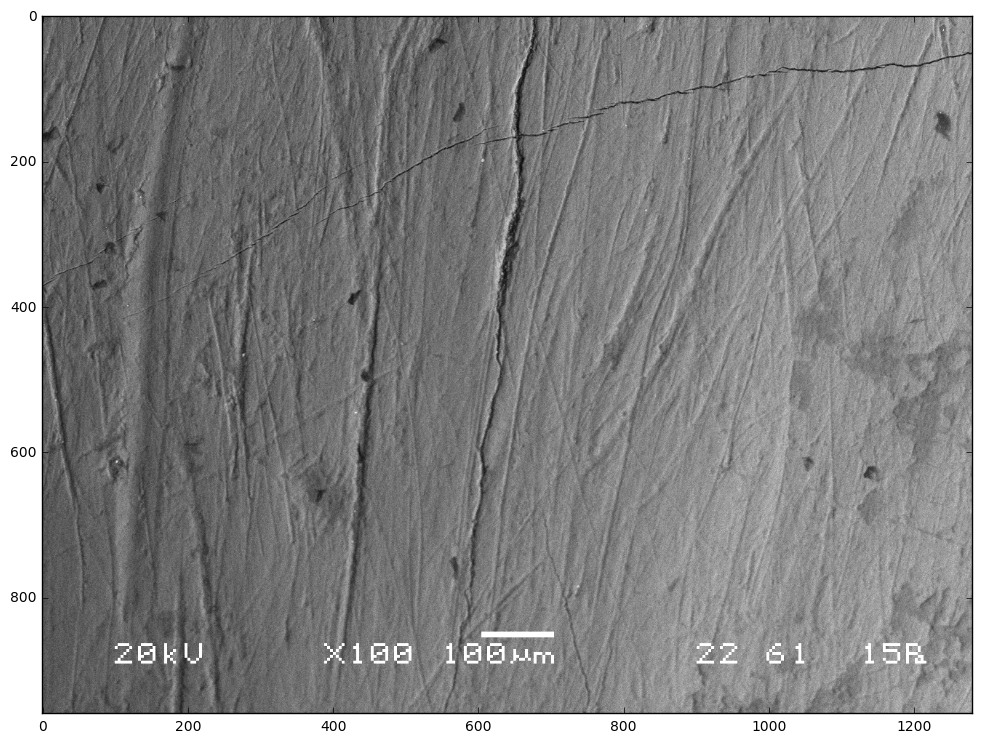

In [4]:
plt.figure(figsize=(12, 12)) 
plt.imshow(img, cmap='gray')

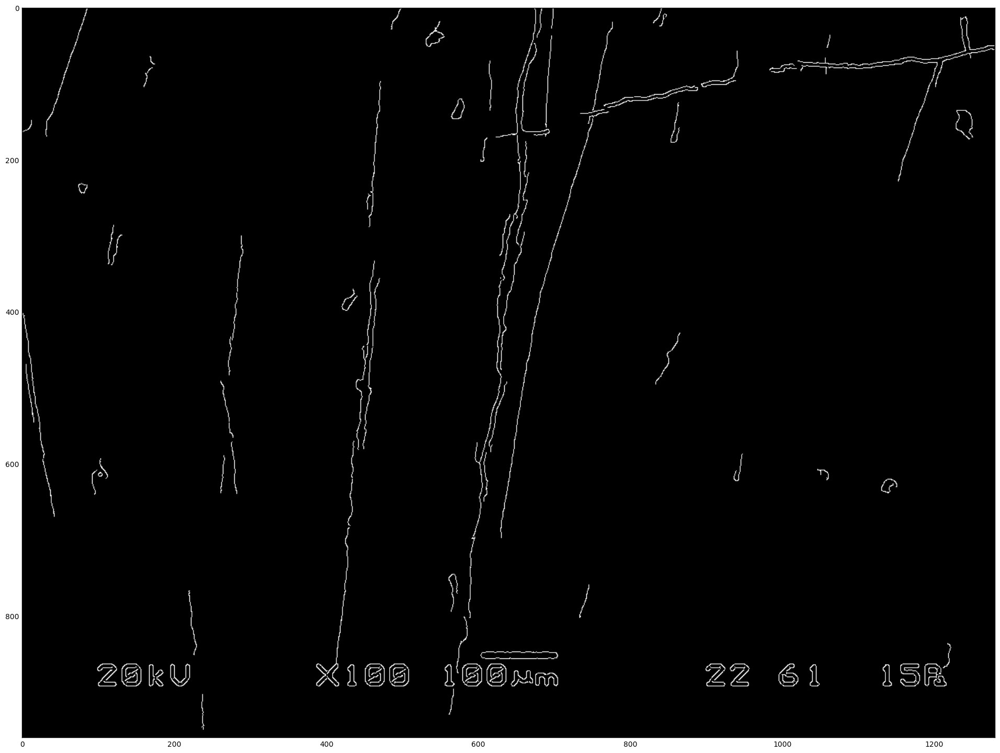

In [6]:
from skimage.restoration import denoise_tv_bregman
image=img
def func(sigma,low_threshold,high_threshold):
    denoised = denoise_tv_bregman(image, 1)
    edges1 = feature.canny(img,sigma,low_threshold,high_threshold)
    plt.figure(figsize=(24, 24)) 
    plt.imshow(edges1, cmap='gray')
w = interactive(func, sigma=2,low_threshold=34, high_threshold=78)#
display(w)

#sigma=1,low_threshold=34,high_threshold=78 +- pero menos menos que mas.
#sigma=2,low_threshold=3,high_threshold=55 +- pero menos menos que mas.


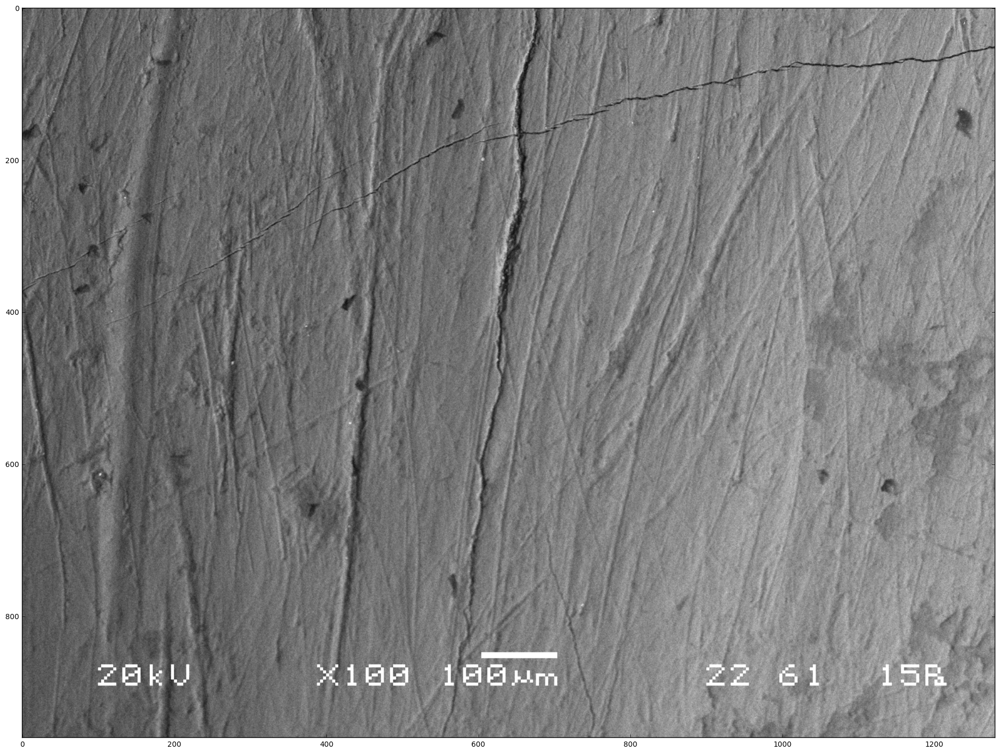

In [6]:
plt.figure(figsize=(24, 24)) 
plt.imshow(img, cmap='gray')

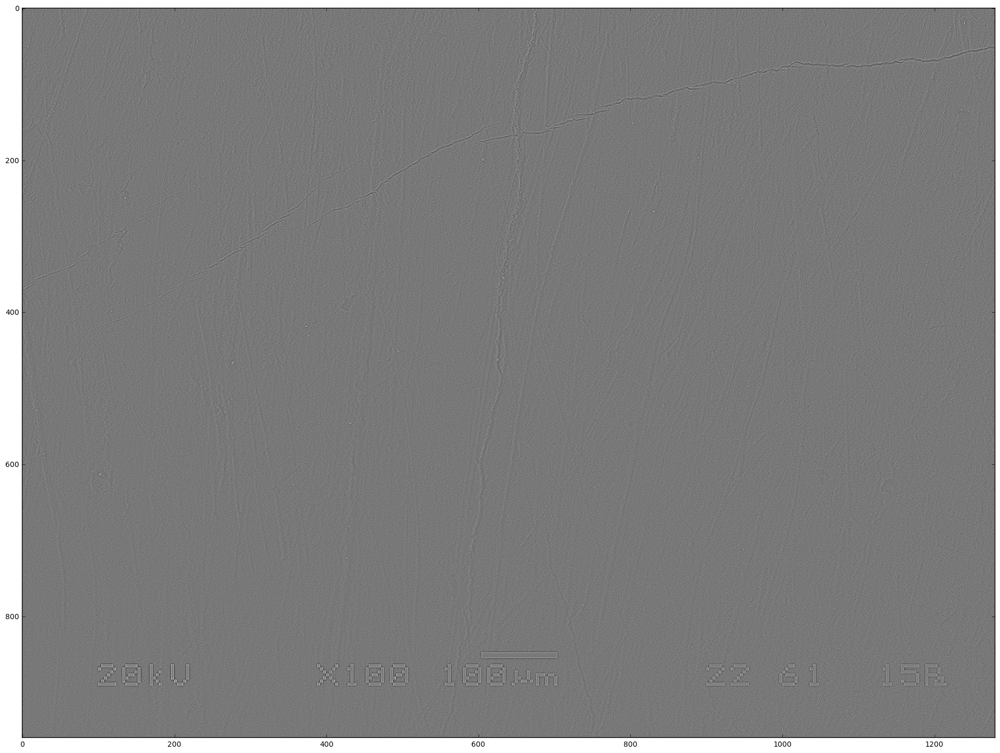

In [7]:
from skimage.filters import laplace,prewitt
bord=laplace(img,ksize=3)
plt.figure(figsize=(24, 24)) 
plt.imshow(bord,cmap='gray')

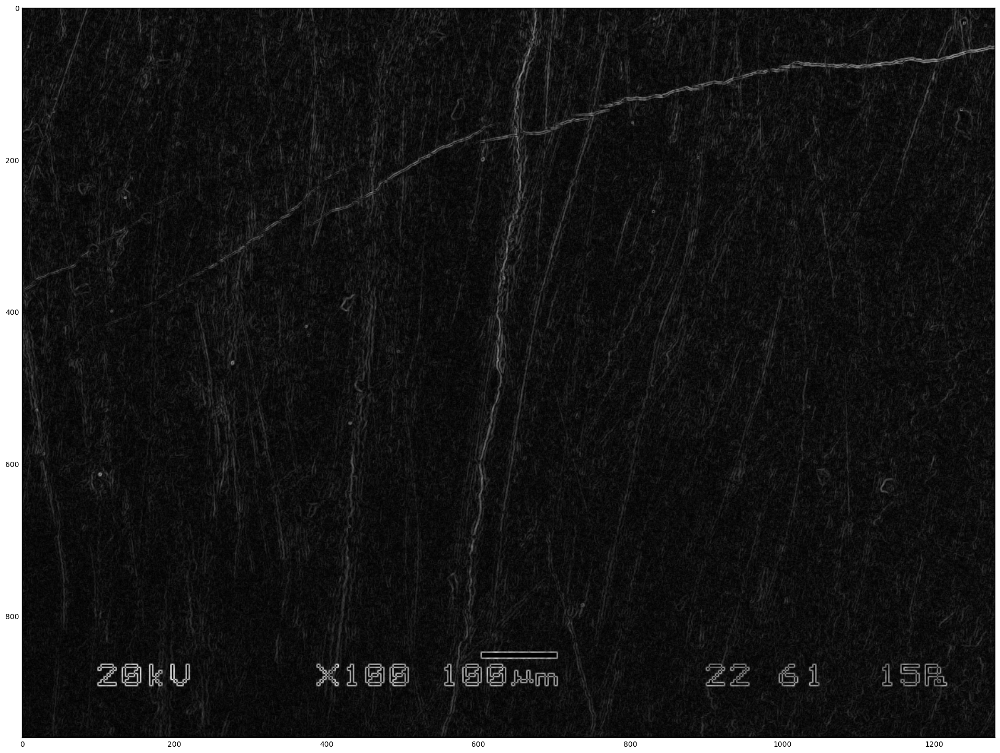

In [8]:
from skimage.filters import prewitt
bord2=prewitt(img)
plt.figure(figsize=(24, 24)) 
plt.imshow(bord2, cmap='gray')

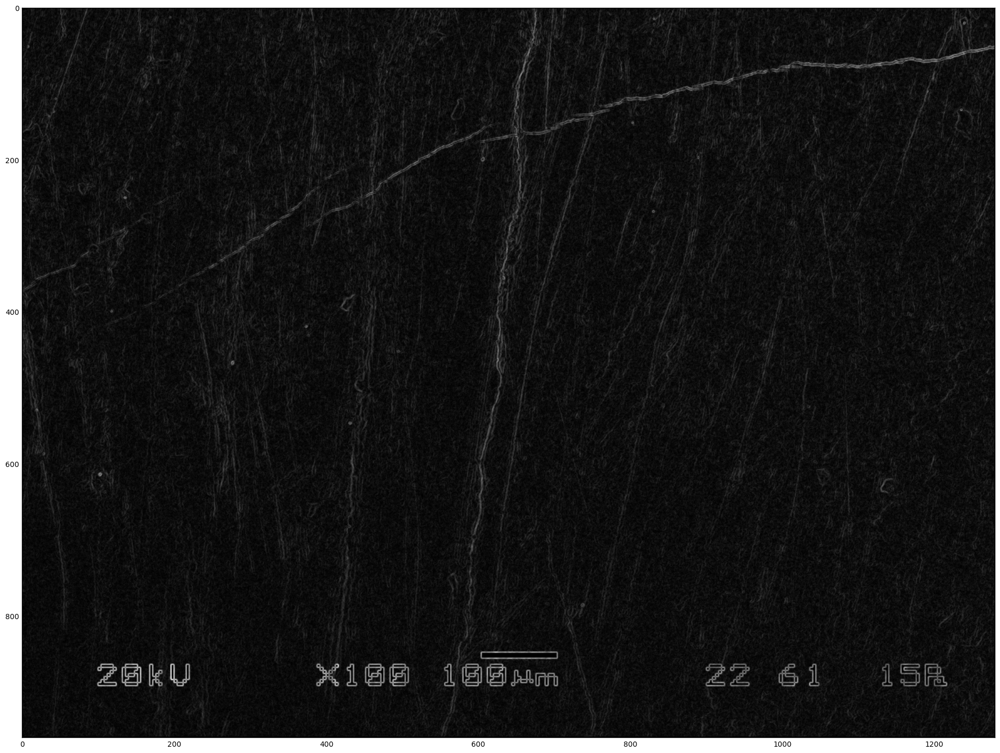

In [9]:
from skimage.filters import scharr
bord3=scharr(img)
plt.figure(figsize=(24, 24)) 
plt.imshow(bord3, cmap='gray')

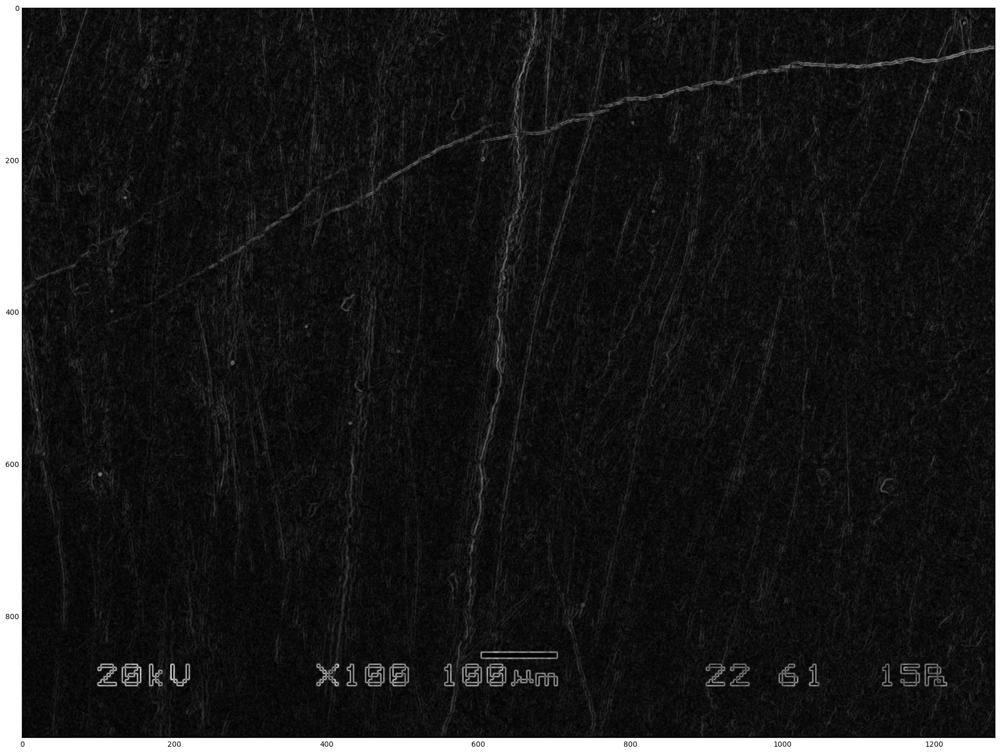

In [10]:
from skimage.filters import sobel
bord4=sobel(img)
plt.figure(figsize=(24, 24)) 
plt.imshow(bord4, cmap='gray')

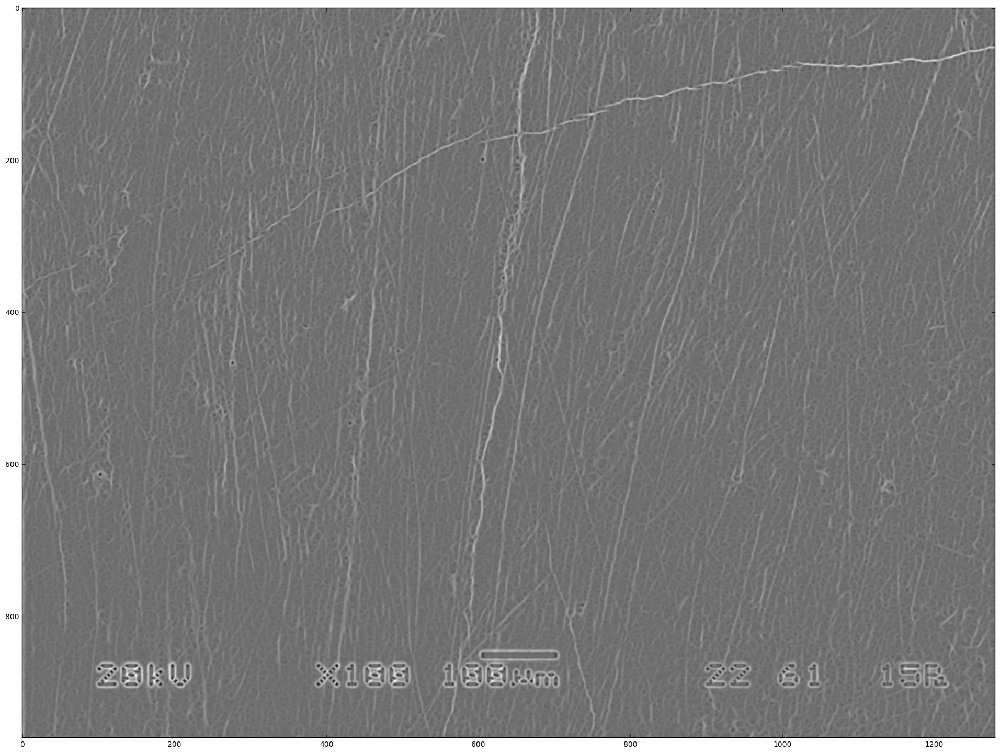

In [11]:
from skimage.feature import hessian_matrix, hessian_matrix_eigvals
from skimage.color import rgb2grey
#assume you have an image img

hxx, hxy, hyy = hessian_matrix(img, sigma=1.7,mode='wrap',cval=0.51)
i1, i2 = hessian_matrix_eigvals(hxx, hxy, hyy)

#i2 is the variable you want.

#Visualise the result

plt.figure(figsize=(24, 24)) 
plt.imshow(i1,cmap='gray')



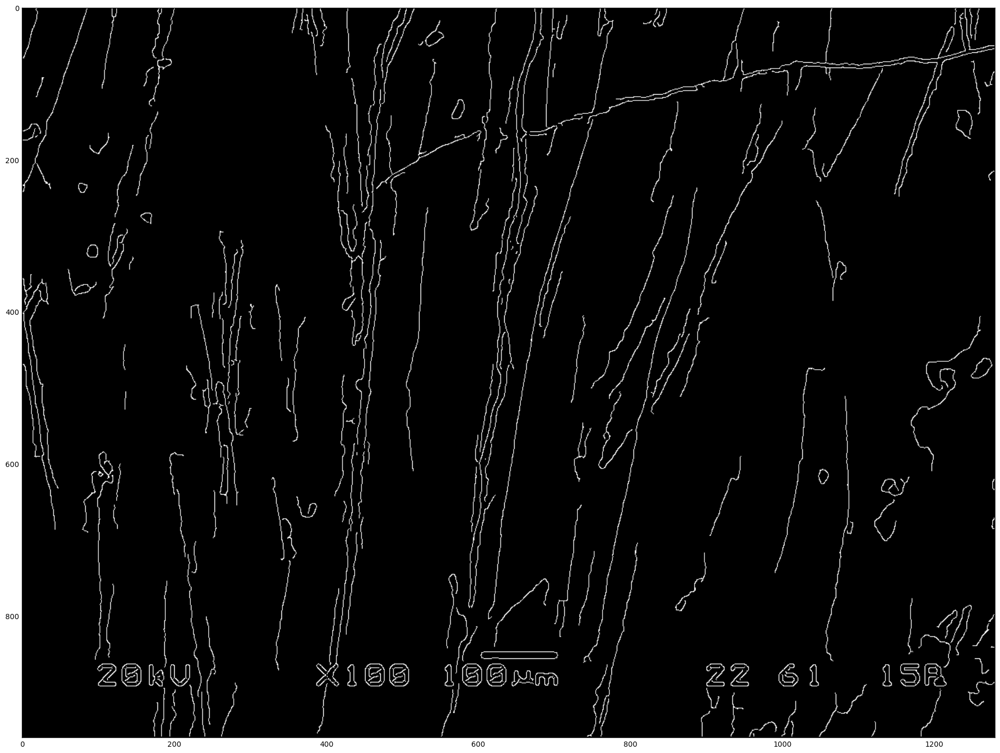

In [12]:
from skimage import io
from skimage import color
from skimage.restoration import denoise_tv_bregman
from skimage.feature import canny
import matplotlib.pyplot as plt

image = img
denoised = denoise_tv_bregman(image, 1)
edges = canny(denoised, 1.4, 0.01, 0.1)


plt.figure(figsize=(24, 24)) 
plt.imshow(edges,cmap='gray')

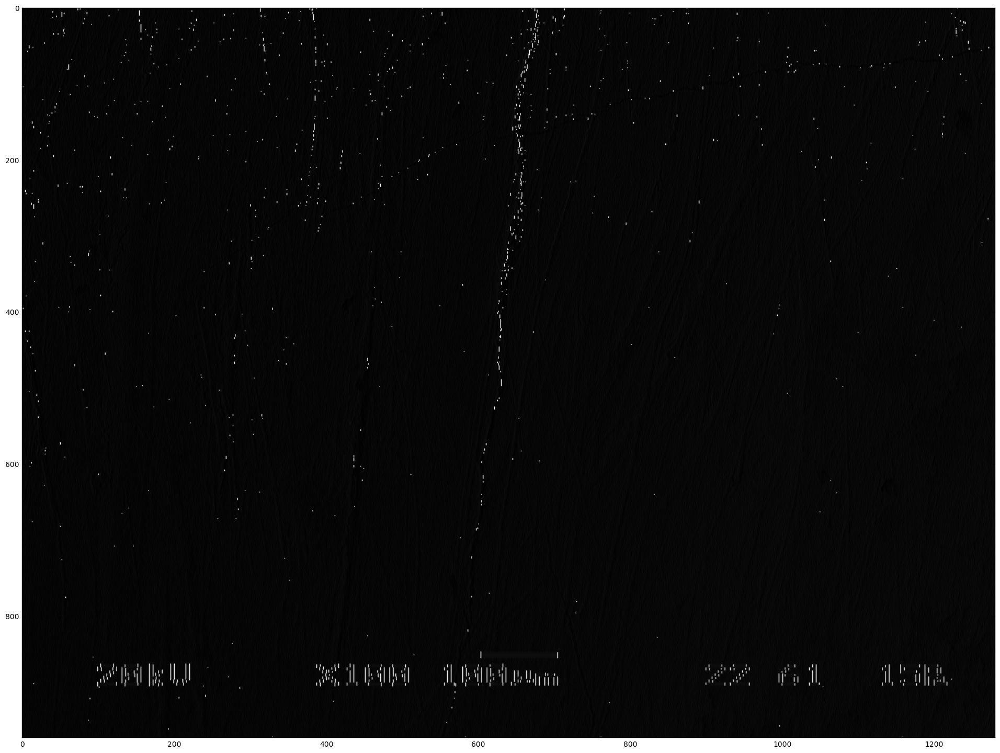

In [13]:
from skimage.filters import gabor,gabor_kernel


filt_real, filt_imag = gabor(img, frequency=0.59)
plt.figure(figsize=(24, 24)) 
plt.imshow(filt_real,cmap='gray')

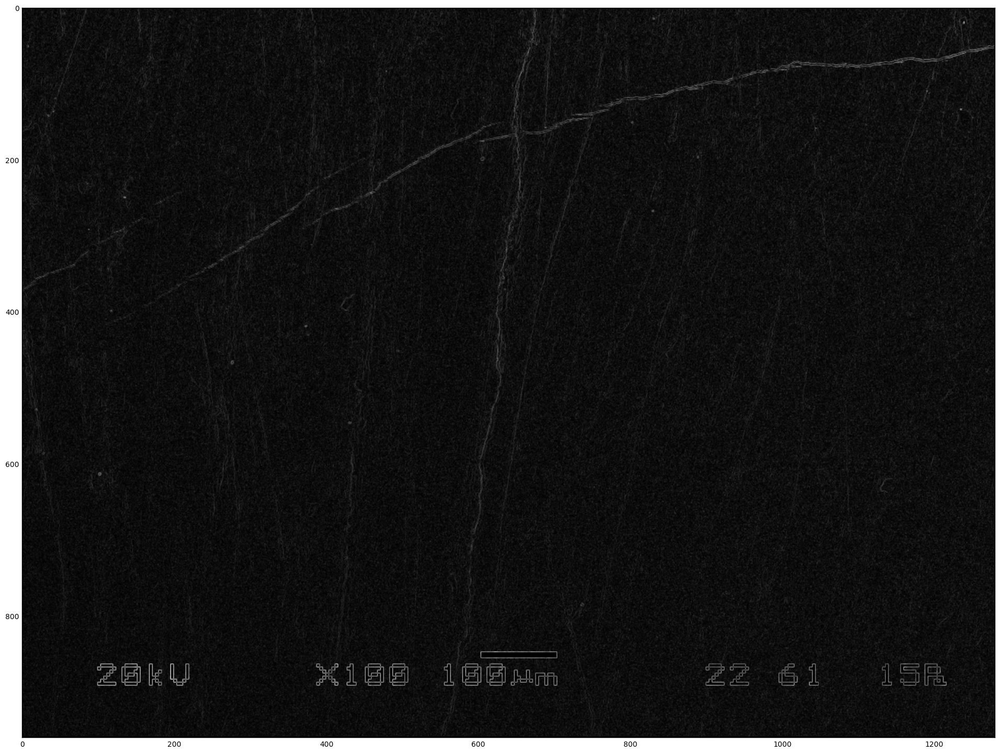

In [14]:
from skimage.filters import roberts,roberts_neg_diag

edge_roberts = roberts(img)
plt.figure(figsize=(24, 24)) 
plt.imshow(edge_roberts,cmap='gray')

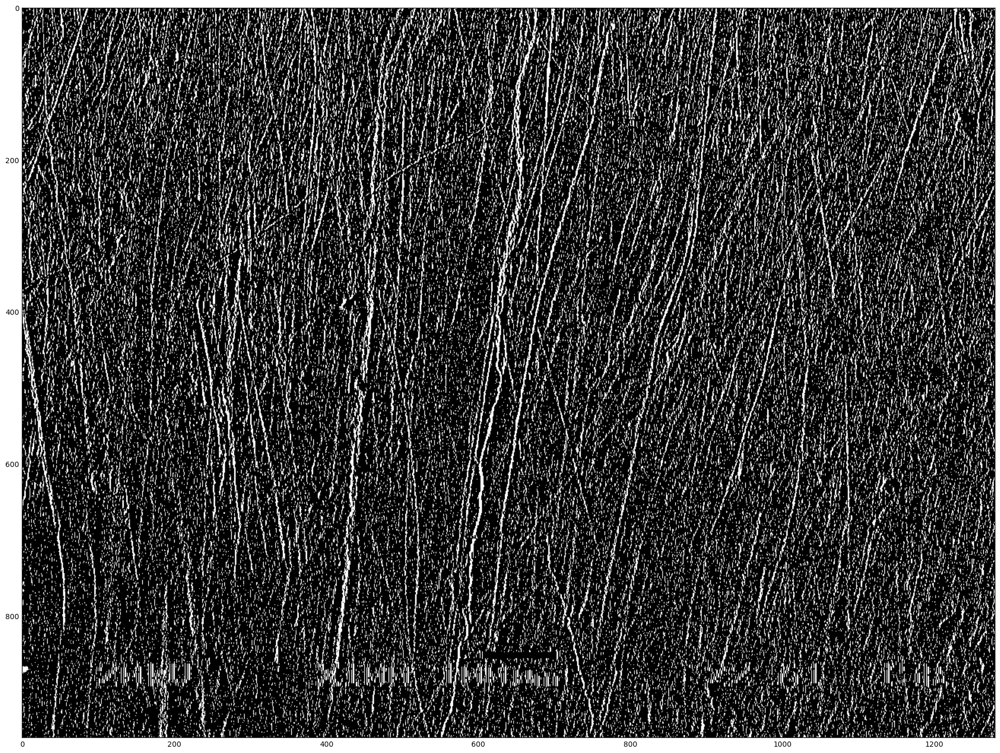

In [15]:
from skimage.filters import threshold_adaptive
th=threshold_adaptive(filt_imag,21,"mean",8,"mirror")
plt.figure(figsize=(24, 24)) 
plt.imshow(th,cmap='gray')

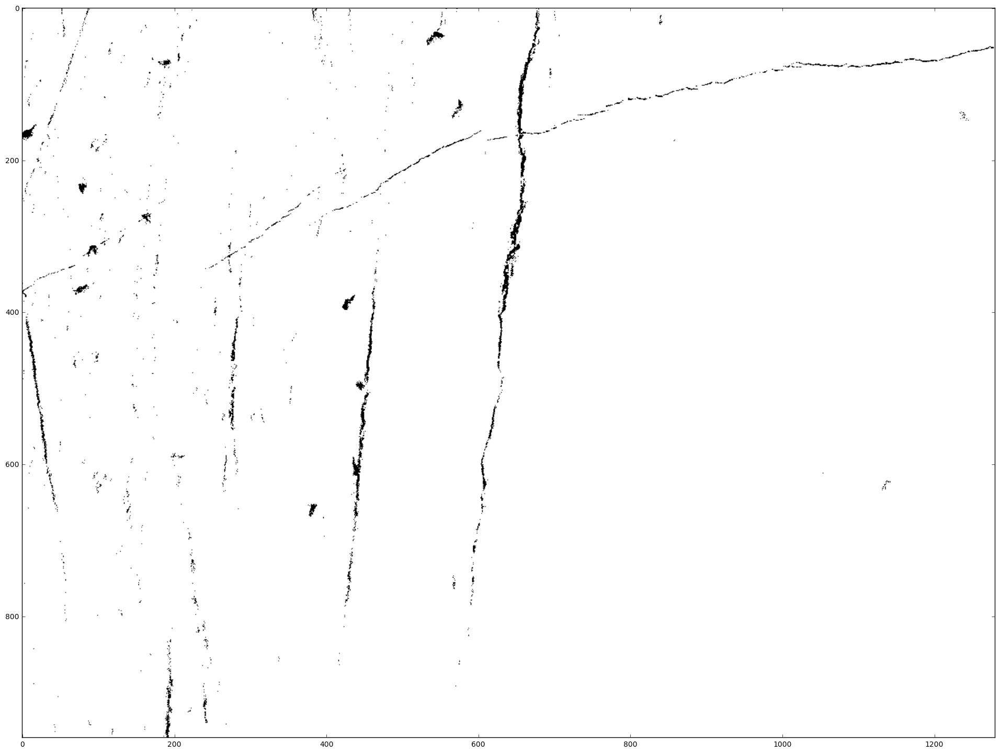

In [16]:
from skimage.filters import threshold_yen
image = img
thresh = threshold_yen(image)
binary = image >= thresh
plt.figure(figsize=(24, 24)) 
plt.imshow(binary,cmap='gray')

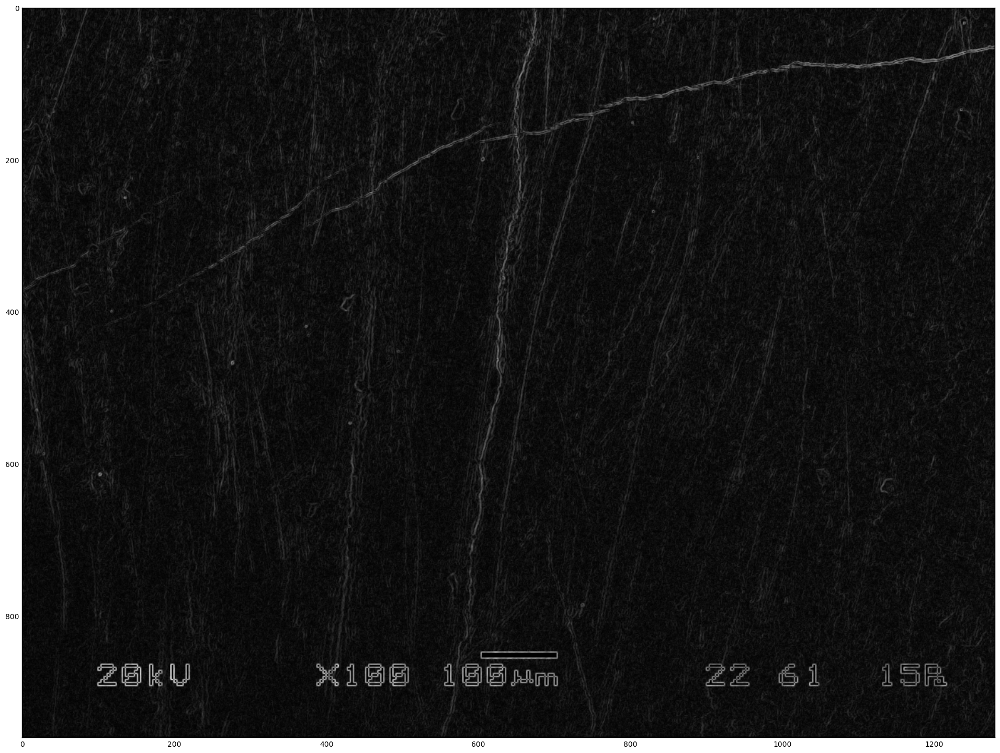

In [17]:
import numpy as np
from skimage import img_as_float
from scipy.ndimage import convolve, binary_erosion, generate_binary_structure

def kirsch(image):
    KIRSCH_WEIGHTS_G1 = np.array([[ 5, 5, 5],
                               [ -3, 0, -3],
                               [-3,-3,-3]]) 
    
    KIRSCH_WEIGHTS_G2 = np.array([[ 5, 5, -3],
                               [ 5, 0, -3],
                               [-3,-3,-3]]) 
    
    KIRSCH_WEIGHTS_G3 = np.array([[ 5, -3, -3],
                               [ 5, 0, -3],
                               [5,-3,-3]]) 
    
    KIRSCH_WEIGHTS_G4 = np.array([[ -3, -3, -3],
                               [ 5, 0, -3],
                               [5,5,-3]]) 
    EROSION_SELEM=generate_binary_structure(2, 2)

    image = img_as_float(image)
    result = convolve(image, KIRSCH_WEIGHTS_G1)
    result[0, :] = 0
    result[-1, :] = 0
    result[:, 0] = 0
    result[:, -1] = 0
    h=result

    result = convolve(image, KIRSCH_WEIGHTS_G2)
    result[0, :] = 0
    result[-1, :] = 0
    result[:, 0] = 0
    result[:, -1] = 0
    hh=result

    result = convolve(image, KIRSCH_WEIGHTS_G3)
    result[0, :] = 0
    result[-1, :] = 0
    result[:, 0] = 0
    result[:, -1] = 0
    hhh=result


    result = convolve(image, KIRSCH_WEIGHTS_G4)
    result[0, :] = 0
    result[-1, :] = 0
    result[:, 0] = 0
    result[:, -1] = 0
    hhhh=result

    return np.sqrt(h**2 + hh**2+hhh**2+hhhh**2)


out=kirsch(img)
plt.figure(figsize=(24, 24))
plt.imshow(out,cmap='gray')